In [1]:
import os

import cv2
import numpy as np
import matplotlib.pyplot as plt


In [2]:
model_input_shape = (224,224,3)

In [3]:
classes = {0: 'background',
 1: 'aeroplane',
 2: 'bicycle',
 3: 'bird',
 4: 'boat',
 5: 'bottle',
 6: 'bus',
 7: 'car',
 8: 'cat',
 9: 'chair',
 10: 'cow',
 11: 'diningtable',
 12: 'dog',
 13: 'horse',
 14: 'motorbike',
 15: 'person',
 16: 'pottedplant',
 17: 'sheep',
 18: 'sofa',
 19: 'train',
 20: 'tvmonitor'}

In [13]:
names=["mean_part_class", "softmax_part_class", "max_part_sal", "softmax_part_scheduled"]
# names=["mean_part_class", "softmax_part_scheduled", "max_part_sal"]
model_names = ["Mean", "Softmax", "Max Saliency", "Scheduled softmax"]
# names=["mean_part_class", "softmax_part_scheduled"]
# names=["cce", ]
name_compliment = ""
# name_compliment = "_part"
img_numbers = list(range(743, 748))
epochs = [0,10,20,30, 40, 50, 60, 70] # , 19]
best_epochs = [69, 43, 57, 41]

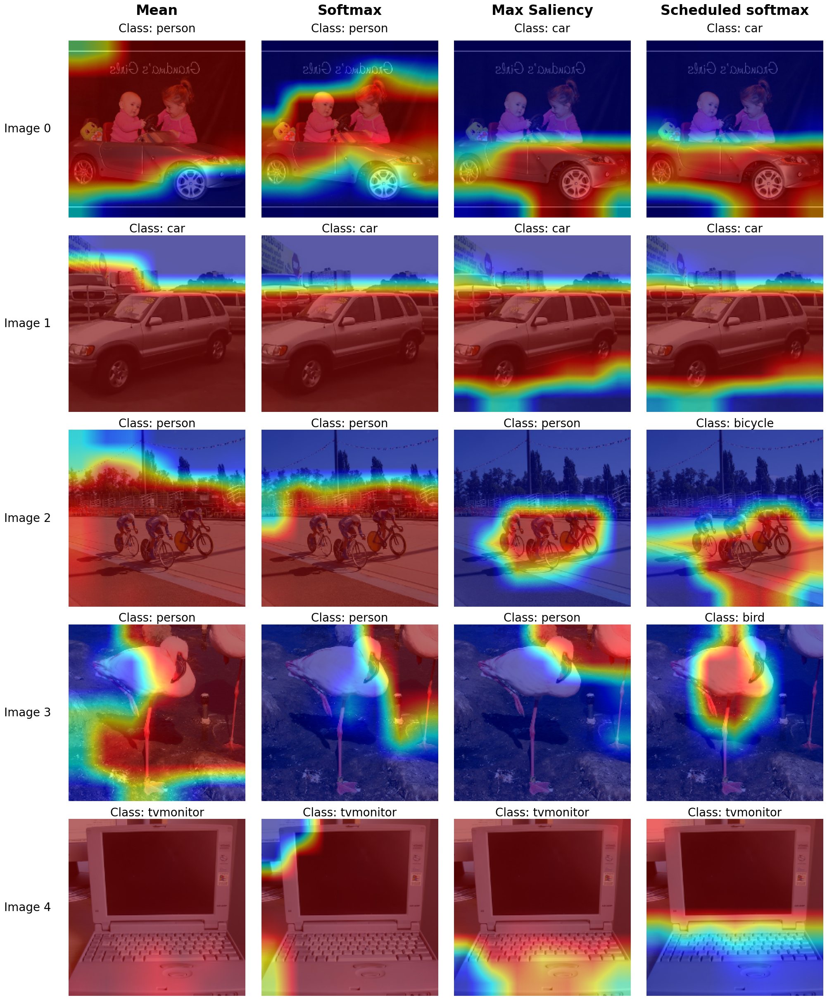

In [18]:
def show_examples_matrix(names: list[str], compliments: str, img_numbers: list[int], best_epochs: list[int]):
    """
    Generates a single figure with a grid of plots, where each column represents a different model
    and each row represents a different image. The plots show a heatmap overlay on the original image.

    Args:
        names (list[str]): A list of model names.
        compliments (str): A string to append to the model names to form the full directory name.
        img_numbers (list[int]): A list of image numbers to plot.
        best_epochs (list[int]): A list of best epoch numbers, one for each model.
        classes (list[str]): A list of class names for the titles.
        model_input_shape (tuple): A tuple containing the height and width of the model's input.
    """
    num_models = len(names)
    num_images = len(img_numbers)

    # Set up the figure and a grid of subplots.
    fig, axes = plt.subplots(num_images, num_models, figsize=(6 * num_models, 6 * num_images), squeeze=False)
    
    # Adjust subplot parameters to create good spacing.
    # hspace is now increased to make room for the class name underneath the first row of images.
    plt.subplots_adjust(hspace=0.1, wspace=0.01)

    # Use a dictionary to store the best epoch for each model name
    epochs_dict = dict(zip(names, best_epochs))

    for col_idx, name in enumerate(names):
        full_name = f"model_{name}{compliments}"
        directory = f"examples/{full_name}"
        epoch = epochs_dict[name]

        for row_idx, im_no in enumerate(img_numbers):
            ax = axes[row_idx, col_idx]

            # Load image and spatial scores
            img = np.load(f"{directory}/{epoch}_augmented_{im_no}_best.npy")
            spatial_scores = np.load(f"{directory}/{epoch}_spatial_scores_{im_no}_best.npy")[0, :, :, 1:]

            # Normalize image
            img_norm = (cv2.normalize(img, None, 0, 1, cv2.NORM_MINMAX) * 255).astype(np.uint8)

            # Determine the largest contributing class and its scores
            largest_contributor = np.argmax(np.mean(spatial_scores, axis=(0, 1)))
            class_name_text = f"Class: {classes[largest_contributor + 1]}"

            scores = spatial_scores[:, :, largest_contributor]

            # Process heatmap overlay
            sp_scores_cls = cv2.resize(scores, model_input_shape[:2], interpolation=cv2.INTER_LINEAR)
            colormap = cv2.applyColorMap((sp_scores_cls * 255).astype(np.uint8), cv2.COLORMAP_JET)
            colormap = cv2.cvtColor(colormap, cv2.COLOR_BGR2RGB)
            
            # Blend heatmap with the image
            alpha = 0.6
            overlay = cv2.addWeighted(img_norm, 1 - alpha, colormap, alpha, 0)
            
            # Display the blended image
            ax.imshow(overlay)
            ax.axis("off")

            # Conditional title setting
            if row_idx == 0:
                # Top row gets the model name as the title
                ax.set_title(model_names[col_idx], fontsize=24, fontweight='bold', pad=45)
                # The class name is placed as text underneath the plot
                ax.text(0.5, 1.10, class_name_text, transform=ax.transAxes, ha='center', va='top', fontsize=20)
            else:
                # All other rows get the class name as the title
                ax.set_title(class_name_text, fontsize=20, pad=5)

            # Label rows with image numbers
            if col_idx == 0:
                ax.text(-0.1, 0.5, f"Image {row_idx}", transform=ax.transAxes, ha='right', va='center', fontsize=20)


# You would call this function like this:
# show_examples_matrix(
#     names=['model_A', 'model_B', 'model_C'],
#     compliments='_best_run',
#     img_numbers=[10, 25, 42],
#     best_epochs=[15, 22, 18], # A list of best epochs for each model
#     classes=['class_1', 'class_2', 'class_3', ...], # Your list of class names
#     model_input_shape=(224, 224) # The height and width of your model's input
# )
show_examples_matrix(names, name_compliment, img_numbers, best_epochs)

Generating heatmap overlays for model: mean_part_class


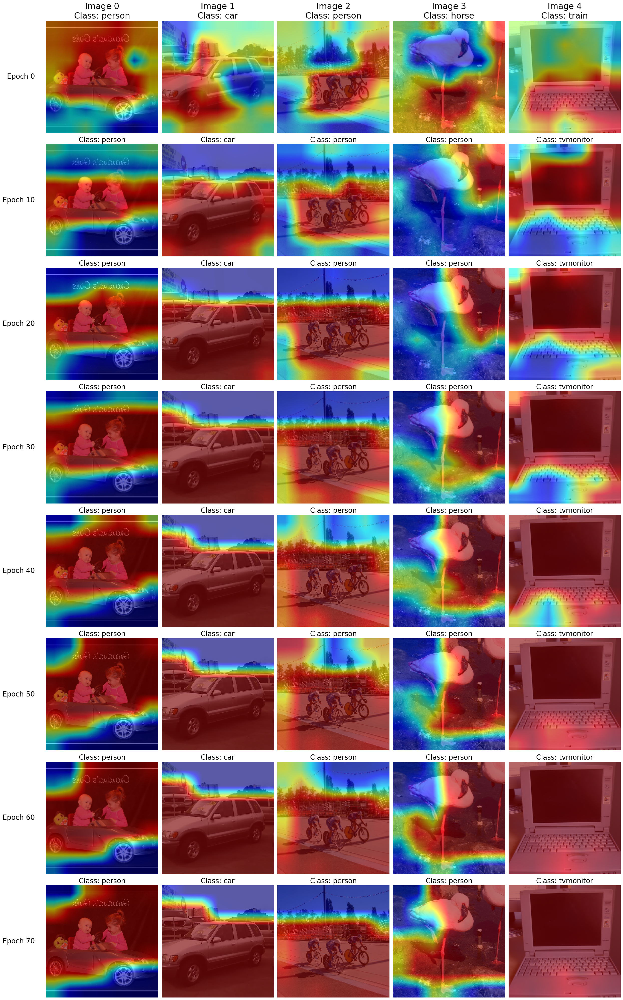

Generating heatmap overlays for model: softmax_part_class


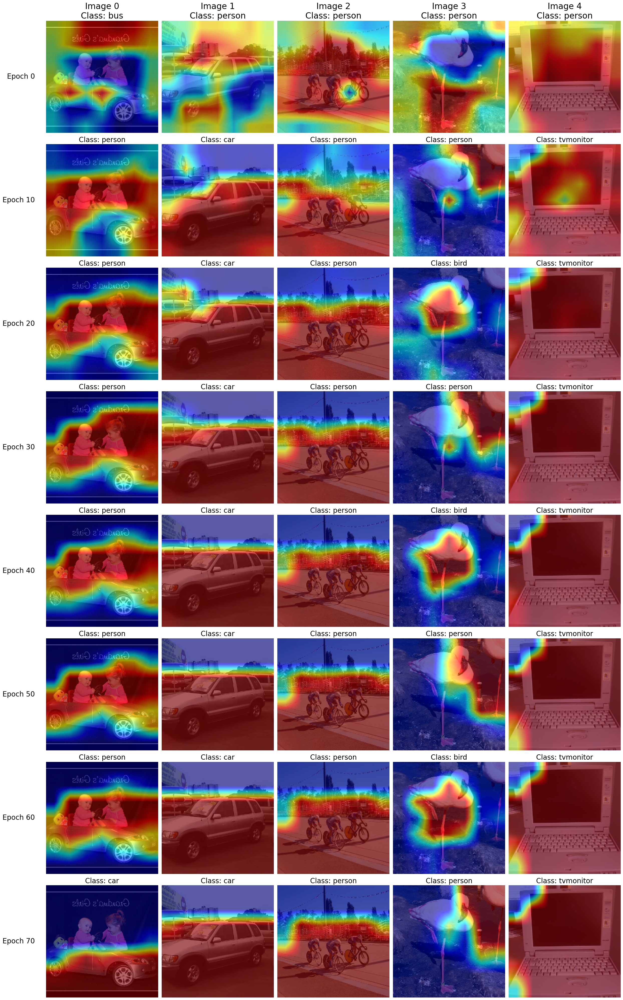

Generating heatmap overlays for model: max_part_sal


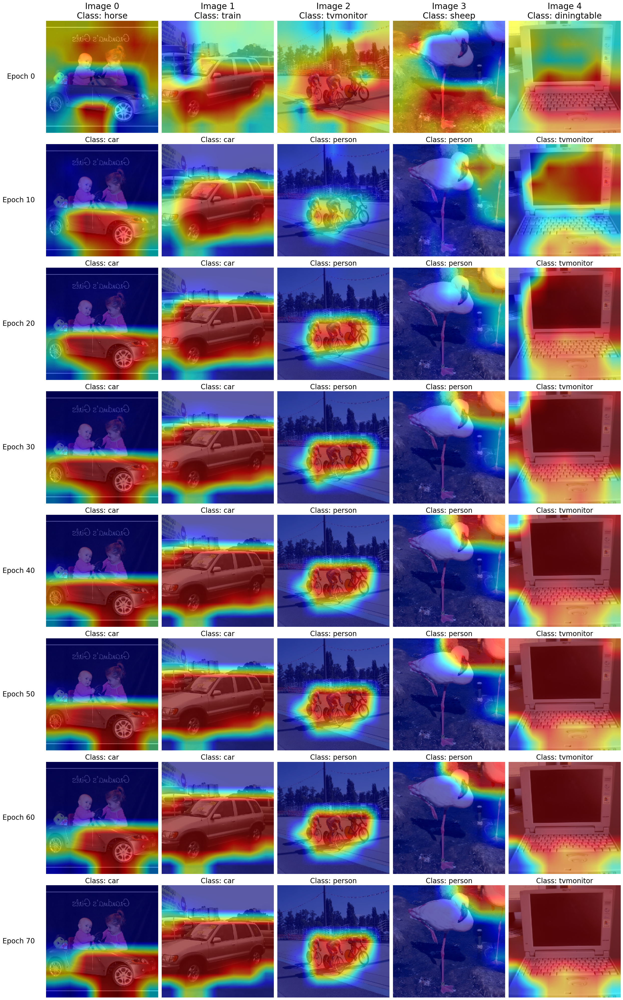

Generating heatmap overlays for model: softmax_part_scheduled


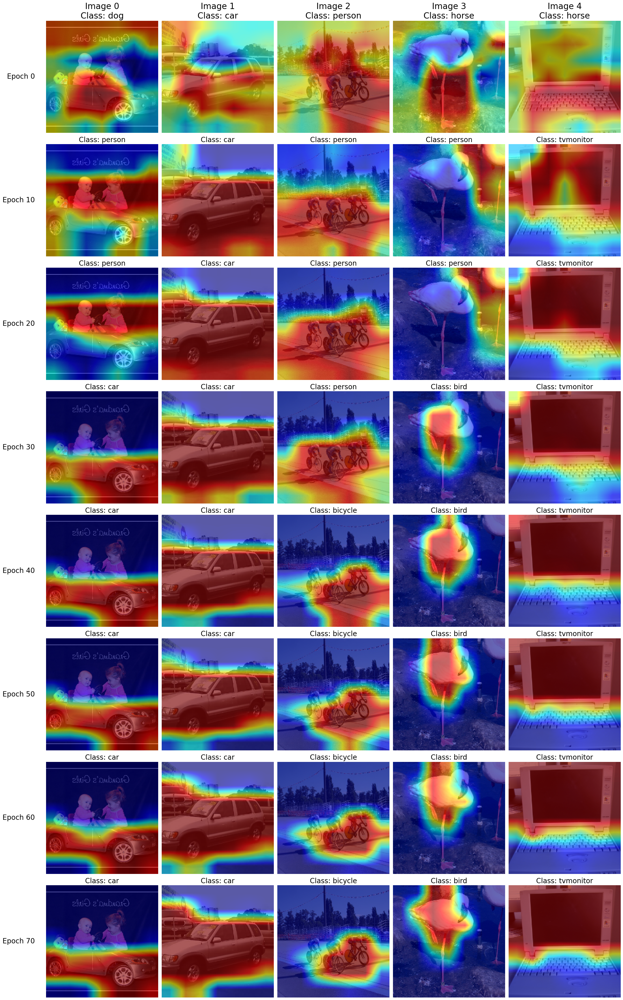

In [16]:
def show_examples_overlay(names: list[str], compliments: str, img_numbers: list[int], epochs: list[int]):
    """
    Generates a single figure for each model, showing a grid of images
    with heatmap overlays.

    The rows of the grid represent different epochs, and the columns
    represent different images.

    Args:
        names (list[str]): A list of model names.
        compliments (str): A string to append to the model names.
        img_numbers (list[int]): A list of image numbers to plot.
        epochs (list[int]): A list of epoch numbers to plot.
        classes (list[str]): A list of class names for the titles.
        model_input_shape (tuple): A tuple containing the height and width of the model's input.
    """
    for name in names:
        print(f"Generating heatmap overlays for model: {name}")
        full_name = "model_" + name + compliments
        directory = "examples/" + full_name
        
        num_cols = len(img_numbers)
        num_rows = len(epochs)
        
        fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows), squeeze=False)
        plt.subplots_adjust(hspace=0.6, wspace=0.4)

        for row_no, epoch in enumerate(epochs):
            for col_no, im_no in enumerate(img_numbers):
                ax = axes[row_no, col_no]
                
                # Load original image and spatial scores
                img = np.load(f"{directory}/{epoch}_augmented_{im_no}.npy")
                spatial_scores = np.load(f"{directory}/{epoch}_spatial_scores_{im_no}.npy")[0, :, :, 1:]

                # Normalize image
                img_norm = (cv2.normalize(img, None, 0, 1, cv2.NORM_MINMAX) * 255).astype(np.uint8)

                # Determine the largest contributing class and its scores
                largest_contributor = np.argmax(np.mean(spatial_scores, axis=(0, 1)))
                scores = spatial_scores[:, :, largest_contributor]

                # Process heatmap overlay
                # Resize the heatmap to match the image dimensions
                sp_scores_cls = cv2.resize(scores, model_input_shape[:2], interpolation=cv2.INTER_LINEAR)
                colormap = cv2.applyColorMap((sp_scores_cls * 255).astype(np.uint8), cv2.COLORMAP_JET)
                colormap = cv2.cvtColor(colormap, cv2.COLOR_BGR2RGB)
                
                # Blend heatmap with the image
                alpha = 0.6
                overlay = cv2.addWeighted(img_norm, 1 - alpha, colormap, alpha, 0)
                
                # Display the blended image
                ax.imshow(overlay)
                ax.axis("off")
                
                # Set titles and labels
                ax.set_title(f"Class: {classes[largest_contributor + 1]}", fontsize=20)
                
                if row_no == 0:
                    ax.set_title(f"Image {col_no}\n{ax.get_title()}", fontsize=24)
                if col_no == 0:
                    ax.text(-0.1, 0.5, f"Epoch {epoch}", transform=ax.transAxes, ha='right', va='center', fontsize=20)
        
        plt.tight_layout()
        plt.savefig(f"{directory}/{name}_overlays.jpg")
        plt.show()
    
show_examples_overlay(names, name_compliment, img_numbers, epochs)

In [7]:
def show_examples(names: list[str], compliments: str, img_numbers: list[int], epochs: list[int]):
    for name in names:
        print(name)
        full_name = "model_" + name + compliments
        directory = "examples/" + full_name
        col = len(img_numbers)
        row = len(epochs) * 2
        fig = plt.figure(figsize=(14,14))
        for row_no, epoch in enumerate(epochs):
            row_no *= 2
            # row_no += 1
            for col_no, im_no in enumerate(img_numbers):
                # col_no += 1
                # col_no *= 2
                img = np.load(f"{directory}/{epoch}_augmented_{im_no}.npy")
                img -= np.min(img)
                img /= np.max(img)
                # print(np.min(img), np.max(img))
                spatial_scores = np.load(f"{directory}/{epoch}_spatial_scores_{im_no}.npy")[0,:,:,1:]
                # print(np.mean(spatial_scores, axis=(0,1)))
                largest_contributor = np.argmax(np.mean(spatial_scores, axis=(0,1)))
                scores = spatial_scores[:,:,largest_contributor]

                plt.subplot(row, col, row_no * col + col_no + 1)
                plt.imshow(img)
                plt.axis("off")

                plt.subplot(row, col, (row_no + 1) * col + col_no + 1)
                # print(np.min(scores), np.max(scores))
                plt.imshow(scores, cmap="viridis", vmin=0.0, vmax=1.0)
                plt.title(classes[largest_contributor + 1])
                plt.axis("off")
                
                
        plt.savefig(f"{directory}/{name}_examples.jpg")
        plt.show()





mean_part_class


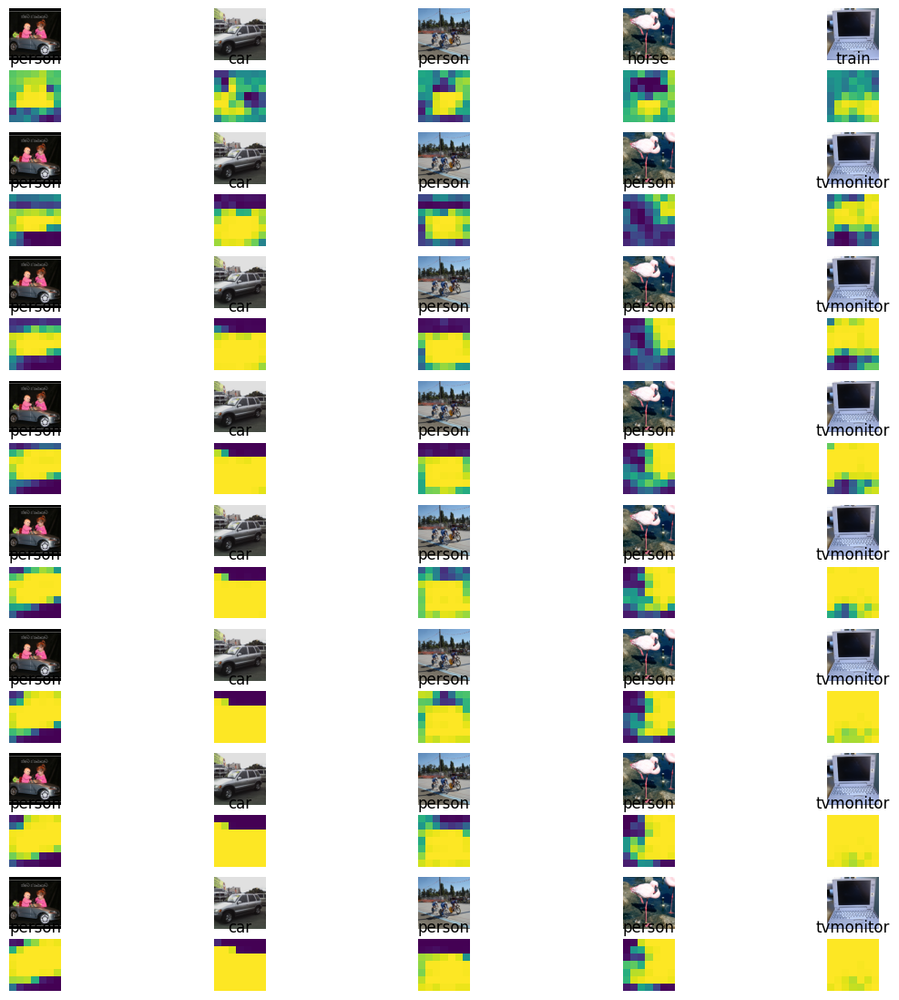

softmax_part_class


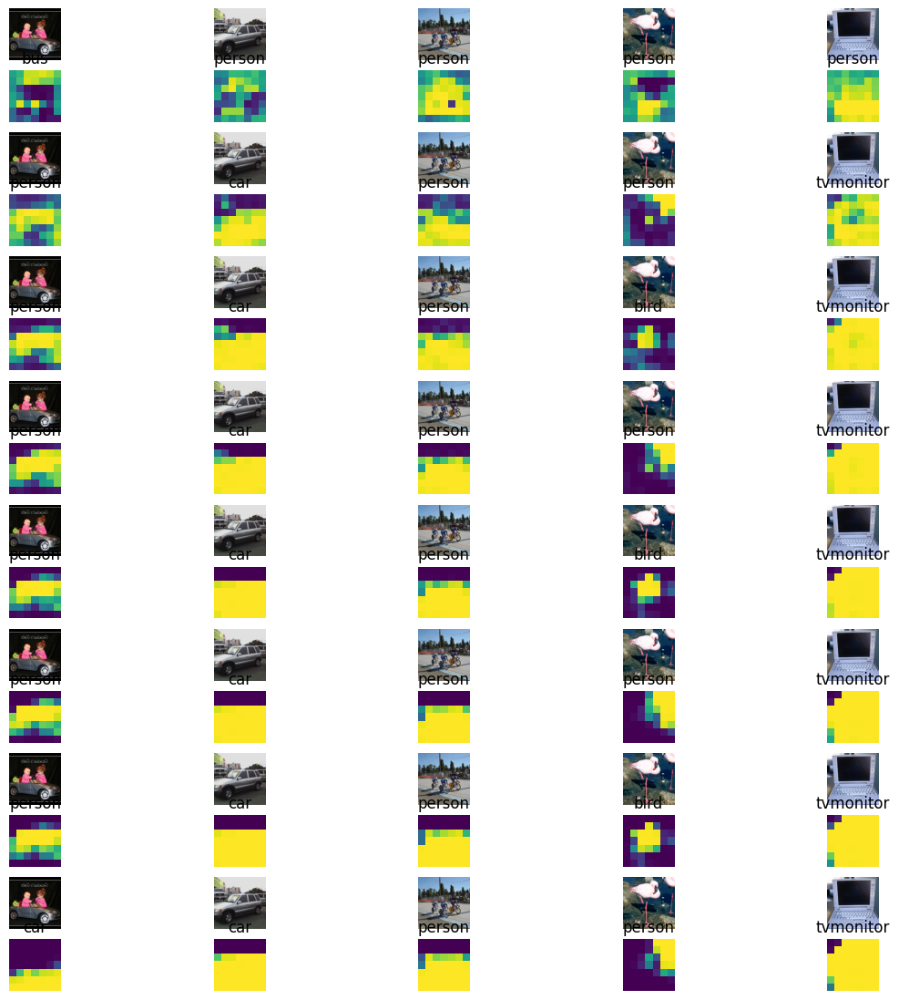

max_part_sal


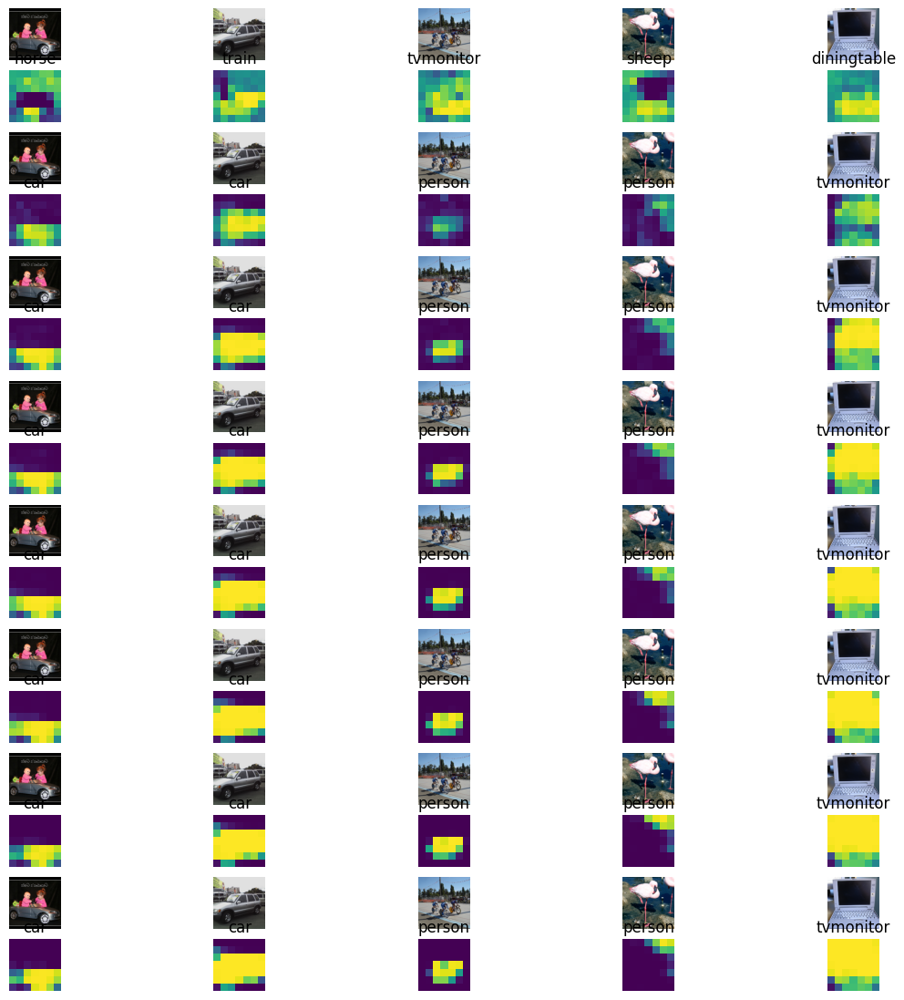

softmax_part_scheduled


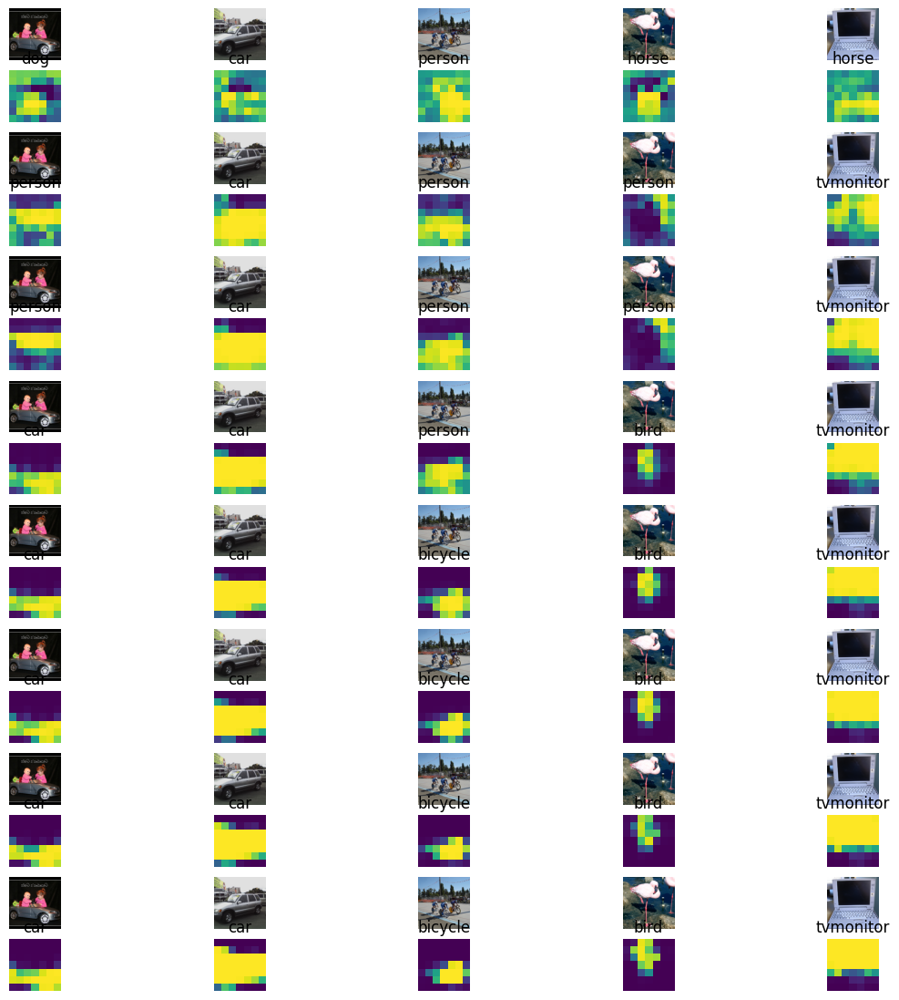

In [8]:
show_examples(names, name_compliment, img_numbers, epochs)

In [9]:
names=["mean", "mean_scheduled", "softmax_cce", "softmax_scheduled", "softmax_scheduled_low_softmax_weight"]
name_compliment = "_full"
img_num = [17119, 17121]
epoch = 5

In [10]:
def show_examples_specific(names, compliments, img_numbers, epoch):
    for name in names:
        print(name)
        if not os.path.exists(f"../imgs/{name}"):
            os.makedirs(f"../imgs/{name}")
        full_name = "model_" + name + compliments
        directory = "examples/" + full_name
        # row_no += 1
        for col_no, im_no in enumerate(img_numbers):
            # col_no += 1
            # col_no *= 2
            img = np.load(f"{directory}/{epoch}_augmented_{im_no}.npy")
            img -= np.min(img)
            img /= np.max(img)
            # print(np.min(img), np.max(img))
            spatial_scores = np.load(f"{directory}/{epoch}_spatial_scores_{im_no}.npy")[0,:,:,1:]
            # print(np.mean(spatial_scores, axis=(0,1)))
            largest_contributor = np.argmax(np.mean(spatial_scores, axis=(0,1)))
            scores = spatial_scores[:,:,largest_contributor]

            plt.imshow(img)
            plt.axis("off")
            plt.savefig(f"../imgs/{name}/image_{im_no}.jpg", bbox_inches="tight")
            plt.show()

            # print(np.min(scores), np.max(scores))
            plt.imshow(scores, cmap="viridis", vmin=0.0, vmax=1.0)
            plt.title(classes[largest_contributor + 1])
            plt.axis("off")
            plt.savefig(f"../imgs/{name}/scores_{im_no}.jpg", bbox_inches="tight")
            plt.show()

            sp_scores_cls = cv2.resize(scores, model_input_shape[:2], interpolation=cv2.INTER_LINEAR)
            colormap = cv2.applyColorMap((sp_scores_cls * 255).astype(np.uint8), cv2.COLORMAP_JET)
            colormap = cv2.cvtColor(colormap, cv2.COLOR_BGR2RGB)  # Convert for Matplotlib
            img_unnormalized = (cv2.normalize(img, None, 0, 1, cv2.NORM_MINMAX) * 255).astype(np.uint8)
            # Blend heatmap with the image
            alpha = 0.6  # Transparency factor
            print(img_unnormalized.shape, colormap.shape)
            overlay = cv2.addWeighted(img_unnormalized, 1 - alpha, colormap, alpha, 0)
            plt.imshow(overlay, cmap="viridis", vmin=0.0, vmax=1.0)

            plt.axis("off")
            plt.savefig(f"../imgs/{name}/heatmap_{im_no}.jpg", bbox_inches="tight")
            plt.show()



mean


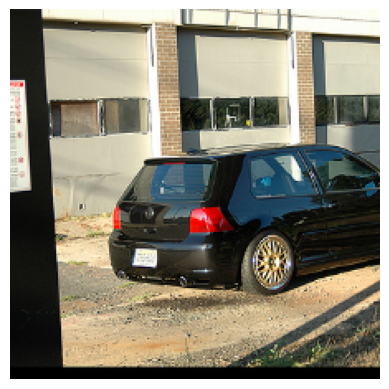

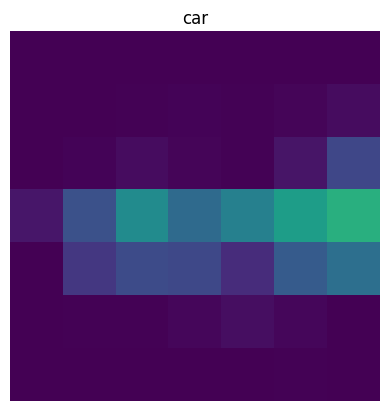

(224, 224, 3) (224, 224, 3)


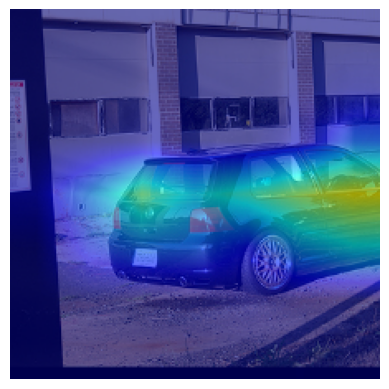

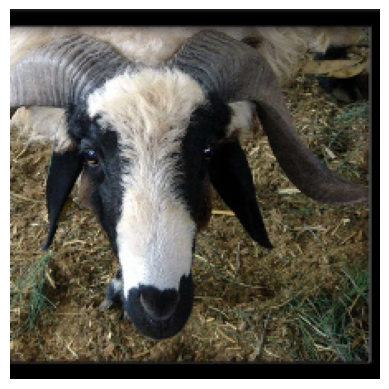

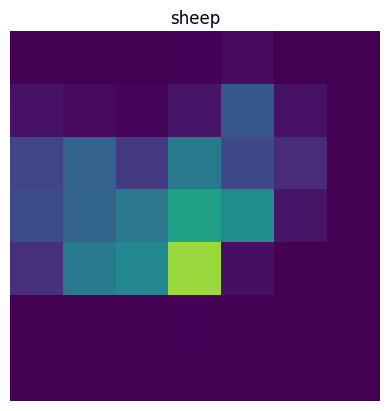

(224, 224, 3) (224, 224, 3)


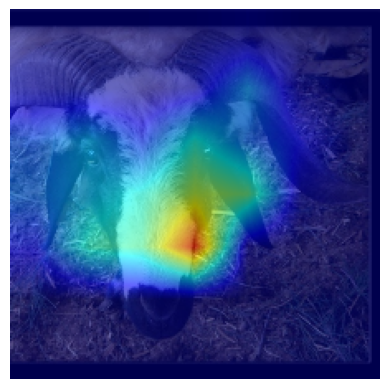

mean_scheduled


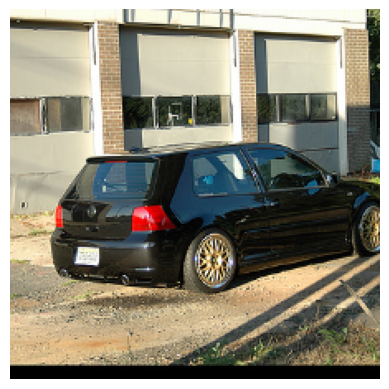

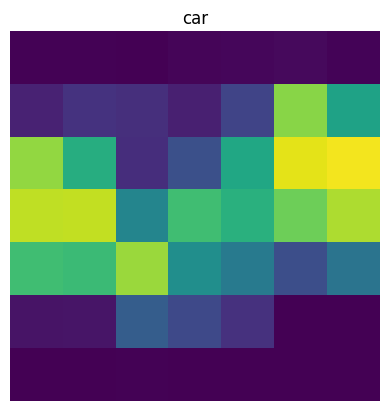

(224, 224, 3) (224, 224, 3)


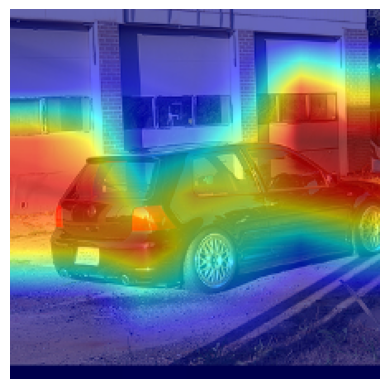

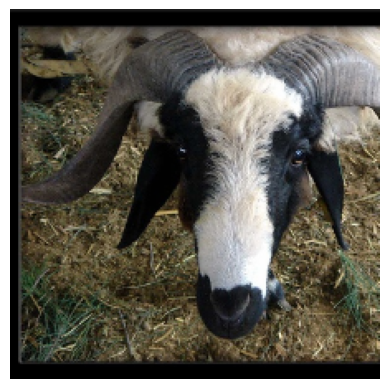

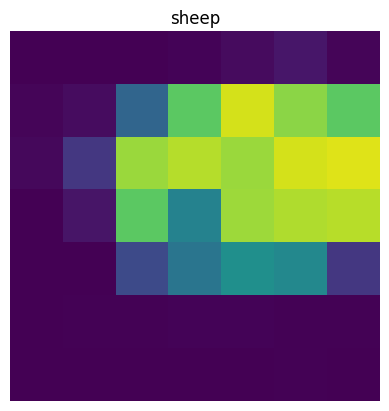

(224, 224, 3) (224, 224, 3)


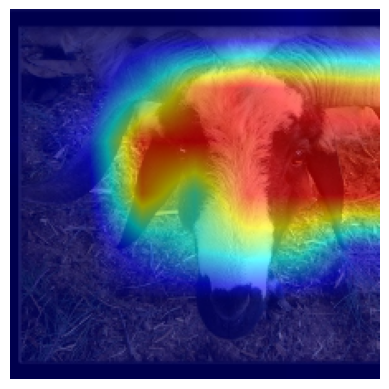

softmax_cce


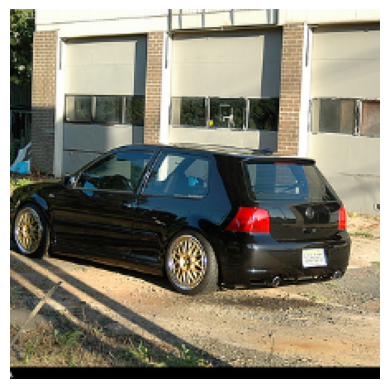

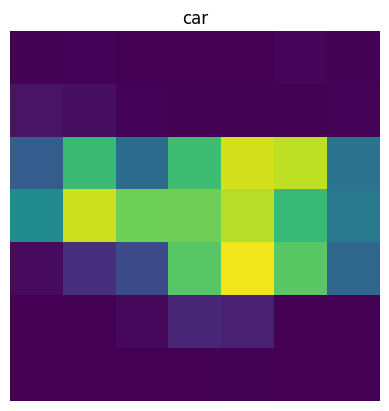

(224, 224, 3) (224, 224, 3)


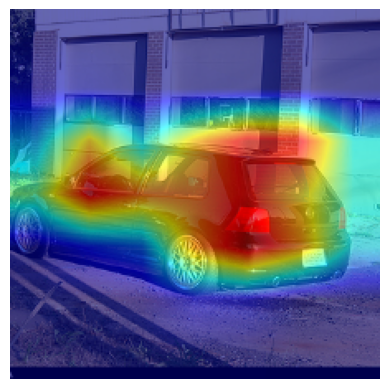

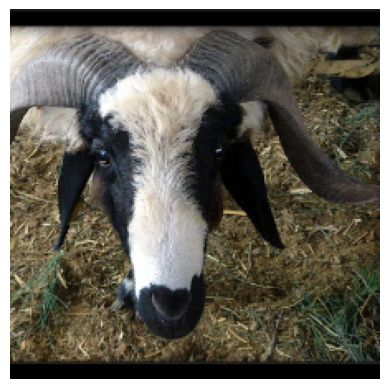

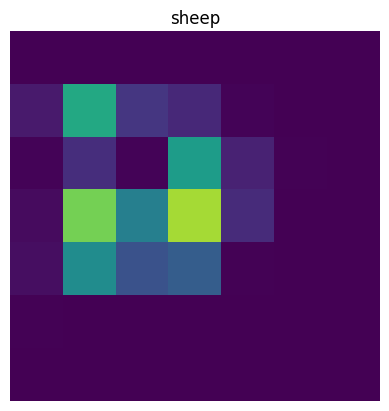

(224, 224, 3) (224, 224, 3)


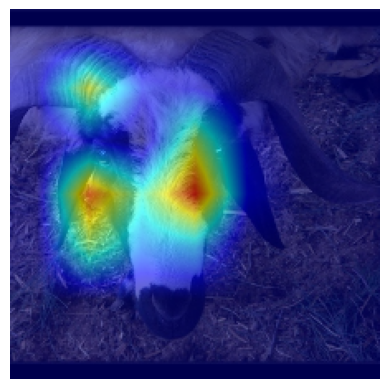

softmax_scheduled


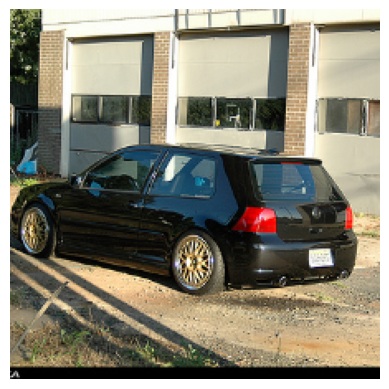

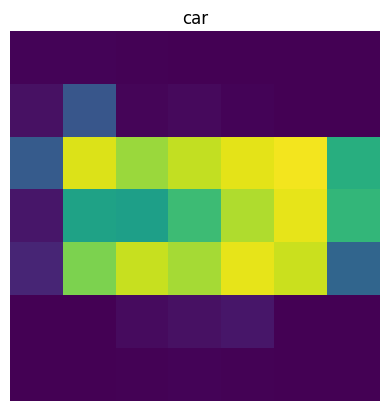

(224, 224, 3) (224, 224, 3)


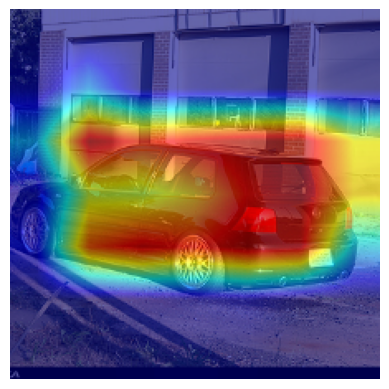

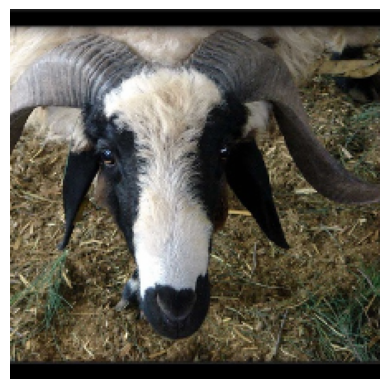

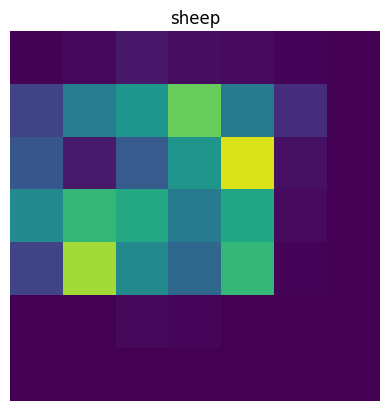

(224, 224, 3) (224, 224, 3)


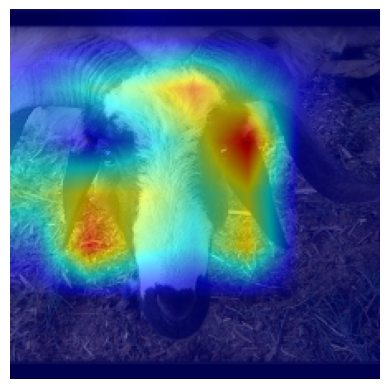

softmax_scheduled_low_softmax_weight


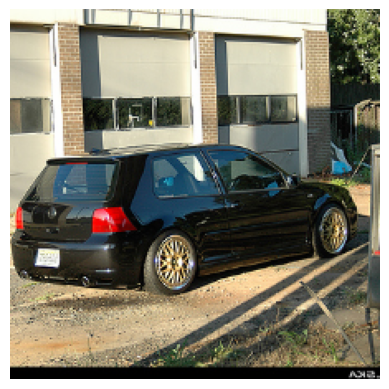

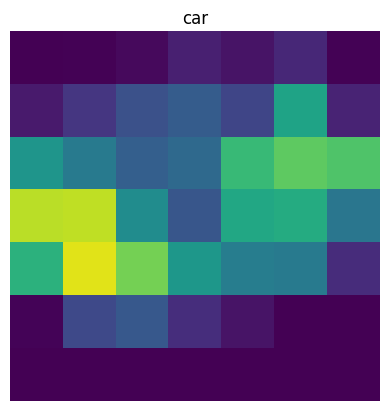

(224, 224, 3) (224, 224, 3)


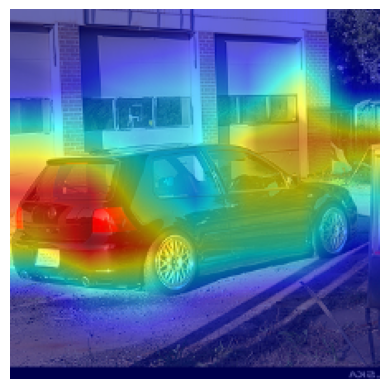

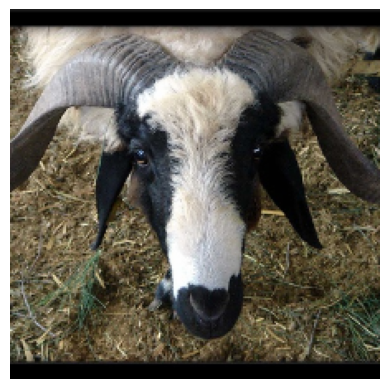

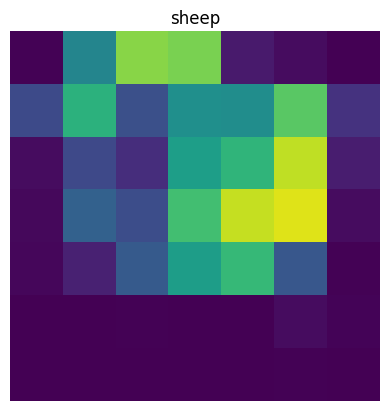

(224, 224, 3) (224, 224, 3)


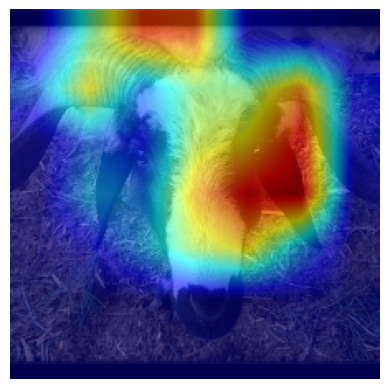

In [11]:
show_examples_specific(names, name_compliment, img_num, epoch)